# **Equipo 1**

Yocelin Juárez Arroyo - A00819828

Luis Arturo Dan Fong - A01650672

Octavio Edelberto Reyes Torres - A00269987


# **Montar bases de datos y lectura de ellas**

In [40]:
from google.colab import drive
drive.mount('/content/drive')
#folder_path = '/content/drive/My Drive/Proyecto Integrador/'
#folder_path = '/content/drive/My Drive/Proyecto Integrador/colab/'
folder_path = '/content/drive/My Drive/Proyecto Integrador/Proyecto Integrador/'

Mounted at /content/drive


In [41]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Ruta del archivo de contactables de Egresados
ruta_archivo = folder_path + 'bases/contactables_EXATEC.csv'

# Leer el archivo Excel
df_contactables = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_contactables.head())


   IA_ID contactable_dominio_correo contactable_estatus
0      6                   itesm.mx      Ciclo Anterior
1     21                  gmail.com      Ciclo Anterior
2     48          grupoceres.com.mx      Ciclo Anterior
3     63               yahoo.com.mx      Ciclo Anterior
4    106                hotmail.com      Ciclo Anterior


In [42]:
# Ruta del archivo con información del comportamiento de marketing de los egresados
ruta_archivo = folder_path + 'bases/MailCampana.csv'

# Leer el archivo Excel
df_marketing = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_marketing.head())

   IA_ID  opened  clicked  replied                             object_id  \
0   21.0       2        0        0  82ede0a1-0076-4aeb-b540-ffd598a33e6b   
1   48.0       4        0        0  7508a1ed-2608-41ce-80a9-a47cddcfdd23   
2  372.0       4        0        0  16c9b8b6-2227-4c53-864f-ceb8e7e34455   
3  372.0       2        0        0  99fc9282-d373-40d3-ade0-7cb937f3408b   
4  372.0       3        0        0  c3963868-9b41-48b6-ac99-76bf916e91af   

   Contacto ID  Correo de marketing ID   Campaña ID  
0    224776056            3.622020e+11  10949903422  
1     60136712            3.633040e+11  10949903422  
2    221283951            3.645170e+11  10949903422  
3    221283951            3.603660e+11  10949903422  
4    221283951            3.622020e+11  10949903422  


In [43]:
# Ruta del archivo con información intereses, residencia, laborales, premios de los egresados
ruta_archivo =  folder_path +  'bases/Infoadicional.csv'

# Leer el archivo Excel
df_intereses = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_intereses.head())

<ipython-input-43-1b8021dd9d20>:5: DtypeWarning: Columns (48,49,51,52,57,61,63,64,68,69,71,72,73,74) have mixed types. Specify dtype option on import or set low_memory=False.
  df_intereses = pd.read_csv(ruta_archivo)


    IA_ID info_ESTADO_RESIDENCIA info_PAIS_RESIDENCIA info_FECHA_MAIL_ACTIVO  \
0  145190             Nuevo León               México       01/08/2023 00:00   
1  162191                    NaN                  NaN       24/06/2024 00:00   
2  155105                    NaN                  NaN       05/05/2023 00:00   
3  176490                    NaN                  NaN       05/05/2023 00:00   
4  175820                    NaN                  NaN       05/05/2023 00:00   

  info_TIPO_DOMICILIO info_POBLACION_ACTIVO   info_MUNICIPIO_ACTIVO  \
0     Dirección Local             Monterrey               Monterrey   
1                 NaN          Villahermosa                     NaN   
2     Dirección Local                   NaN          Aguascalientes   
3     Dirección Local                   NaN  San Pedro Garza García   
4     Dirección Local                   NaN               Guadalupe   

  info_ESTADO_ACTIVO info_PAIS_ACTIVO info_FECHA_ACTIVO  ...  \
0         Nuevo León        

In [44]:
# Ruta del archivo con información escolar de los egresados
ruta_archivo = folder_path +  'bases/IA_BaseEXATEC_entregada.csv'

# Leer el archivo Excel
df_escolar = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_escolar.head())

<ipython-input-44-c8c1f5e053ed>:5: DtypeWarning: Columns (2,14,34,35,36) have mixed types. Specify dtype option on import or set low_memory=False.
  df_escolar = pd.read_csv(ruta_archivo)


   IA_ID  base_SEXO base_año nac base_NACIONALIDAD base_CIUDADNACIMIENTO  \
0      6  Masculino         1928          Mexicana                México   
1     21  Masculino         1928          Mexicana            Indefinido   
2     48  Masculino         1931          Mexicana            Indefinido   
3     63  Masculino         1930          Mexicana             Monterrey   
4    106  Masculino         1929          Mexicana             Monterrey   

  base_ESTADONACIMIENTO base_PAISNACIMIENTO base_NOCONTACTAR  \
0      Ciudad de México          Indefinido                    
1                                                              
2               Sinaloa              México                    
3            Nuevo León              México                    
4            Nuevo León              México                    

  base_exatec personalizado base_CIUDAD_RESIDENCIA  ... base_CDEMPRESA  \
0                        No                    NaN  ...            NaN   
1         

In [45]:
# Ruta del archivo con información egresados suscritos a un medio de comunicación
ruta_archivo =  folder_path + 'bases/egresados_suscritos_medios.csv'

# Leer el archivo Excel
df_suscritos = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_suscritos.head())

    IA_ID suscrito_FechaRegistro
0  312476       05/02/2021 13:00
1  297273       05/02/2021 13:00
2  283769       10/09/2020 14:25
3  312737       05/02/2021 13:00
4  304946       10/09/2020 14:25


In [46]:
# Ruta del archivo con información de egresados que participaron en la ultima campaña
ruta_archivo =  folder_path + 'bases/giveaway_actualizacion.csv'

# Leer el archivo Excel
df_giveaway = pd.read_csv(ruta_archivo)

# Mostrar las primeras filas del archivo
print(df_giveaway.head())

    IA_ID    giveaway_fecha
0  313133  25/09/2024 22:18
1   65913  25/09/2024 22:18
2   51646  25/09/2024 22:18
3  327947  25/09/2024 22:18
4   63267  25/09/2024 22:18


In [47]:
# Uniremos los DataFrames utilizando 'IA_ID' como clave
df_unido = pd.merge(df_contactables, df_marketing, on='IA_ID', how='left')
df_unido = pd.merge(df_unido, df_intereses, on='IA_ID', how='left')
df_unido = pd.merge(df_unido, df_escolar, on='IA_ID', how='left')
df_unido = pd.merge(df_unido, df_suscritos, on='IA_ID', how='left')
df_unido = pd.merge(df_unido, df_giveaway, on='IA_ID', how='left')


# Mostrar el DataFrame resultante
print(df_unido)

         IA_ID contactable_dominio_correo contactable_estatus  opened  \
0            6                   itesm.mx      Ciclo Anterior     NaN   
1           21                  gmail.com      Ciclo Anterior     2.0   
2           48          grupoceres.com.mx      Ciclo Anterior     4.0   
3           63               yahoo.com.mx      Ciclo Anterior     NaN   
4          106                hotmail.com      Ciclo Anterior     NaN   
...        ...                        ...                 ...     ...   
529883  370520                hotmail.com      Ciclo Anterior     NaN   
529884  370520                hotmail.com      Ciclo Anterior     NaN   
529885  370520                hotmail.com      Ciclo Anterior     NaN   
529886  370520                hotmail.com      Ciclo Anterior     NaN   
529887  370520                hotmail.com      Ciclo Anterior     NaN   

        clicked  replied                             object_id  Contacto ID  \
0           NaN      NaN                    

In [48]:
#Unir DF con una iniciativa LDG Incubadora
ruta_archivo =  folder_path + 'bases/LDG incubadora.csv'

# Leer el archivo Excel
df_incubadora = pd.read_csv(ruta_archivo)


In [49]:
df_incubadora['es_LDGincubadora'] = 1
df_unidoLDG = pd.merge(df_unido, df_incubadora, on='IA_ID', how='left', indicator=True)
df_unidoLDG['es_LDGincubadora'] = np.where(df_unidoLDG['es_LDGincubadora'] == 1, 1, 0)

print(df_unidoLDG['_merge'].value_counts())  # Mostrar conteo de coincidencias y no coincidencias


# Mostrar las primeras filas del archivo
print(df_incubadora.head())
# Mostrar el DataFrame resultante
print(df_unidoLDG)

_merge
left_only     512424
both           17485
right_only         0
Name: count, dtype: int64
      IA_ID    Categoría Lider                       Campus  Año Graduación  \
0  357450.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
1  355251.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
2  355639.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
3  355278.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
4  356922.0  Líder por Carrera  TEC Campus Ciudad de México            2023   

  Mes Graduación                                          Carrera  \
0          Junio                      Licenciado en Mercadotecnia   
1          Junio                     Licenciado en Emprendimiento   
2          Junio   Licenciado en Psicología Clínica y de la Salud   
3      Diciembre  Licenciado en Creación y Desarrollo de Empresas   
4      Diciembre                       Ingeniero en Biotecnología   

  Nivel (Carre

In [50]:
#Unir con voluntariado
#Unir DF con una iniciativa LDG Incubadora
ruta_archivo =  folder_path + 'bases/Voluntariado.csv'

# Leer el archivo Excel
df_coluntariado = pd.read_csv(ruta_archivo)

df_incubadora['es_LDGincubadora'] = 1
df_unidoLDG = pd.merge(df_unido, df_incubadora, on='IA_ID', how='left', indicator=True)
df_unidoLDG['es_LDGincubadora'] = np.where(df_unidoLDG['es_LDGincubadora'] == 1, 1, 0)

print(df_unidoLDG['_merge'].value_counts())  # Mostrar conteo de coincidencias y no coincidencias


# Mostrar las primeras filas del archivo
print(df_incubadora.head())
# Mostrar el DataFrame resultante
print(df_unidoLDG)

_merge
left_only     512424
both           17485
right_only         0
Name: count, dtype: int64
      IA_ID    Categoría Lider                       Campus  Año Graduación  \
0  357450.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
1  355251.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
2  355639.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
3  355278.0  Líder por Carrera  TEC Campus Ciudad de México            2023   
4  356922.0  Líder por Carrera  TEC Campus Ciudad de México            2023   

  Mes Graduación                                          Carrera  \
0          Junio                      Licenciado en Mercadotecnia   
1          Junio                     Licenciado en Emprendimiento   
2          Junio   Licenciado en Psicología Clínica y de la Salud   
3      Diciembre  Licenciado en Creación y Desarrollo de Empresas   
4      Diciembre                       Ingeniero en Biotecnología   

  Nivel (Carre

In [51]:
#Por seguridad desconectamos de drive
from google.colab import drive
drive.flush_and_unmount()

# **Pregunta 1: ¿Hay valores faltantes en el conjunto de datos? ¿Se pueden identificar patrones de ausencia?**

In [52]:
#Verificamos datos faltantes
print(df_unido.isnull().sum())  # Muestra cuántos valores faltantes hay en cada columna


IA_ID                              0
contactable_dominio_correo         0
contactable_estatus                0
opened                        127966
clicked                       127966
                               ...  
base_INTERESES                508847
base_updatedata               520509
base_HizoPrepaTec                 11
suscrito_FechaRegistro        168387
giveaway_fecha                426076
Length: 127, dtype: int64


In [53]:
#Necesitaremos visualizar de una mejor manera la cantidad relativa de datos faltantes por ello se requiere ver el porcenaje
# Porcentaje de valores faltantes en cada columna
missing_data_percent = (df_unido.isnull().sum() / len(df_unido)) * 100
print("Porcentaje de valores faltantes en cada columna:\n", missing_data_percent)


Porcentaje de valores faltantes en cada columna:
 IA_ID                          0.000000
contactable_dominio_correo     0.000000
contactable_estatus            0.000000
opened                        24.149632
clicked                       24.149632
                                ...    
base_INTERESES                96.029161
base_updatedata               98.230003
base_HizoPrepaTec              0.002076
suscrito_FechaRegistro        31.777847
giveaway_fecha                80.408690
Length: 127, dtype: float64


Visualizar los valores faltantes

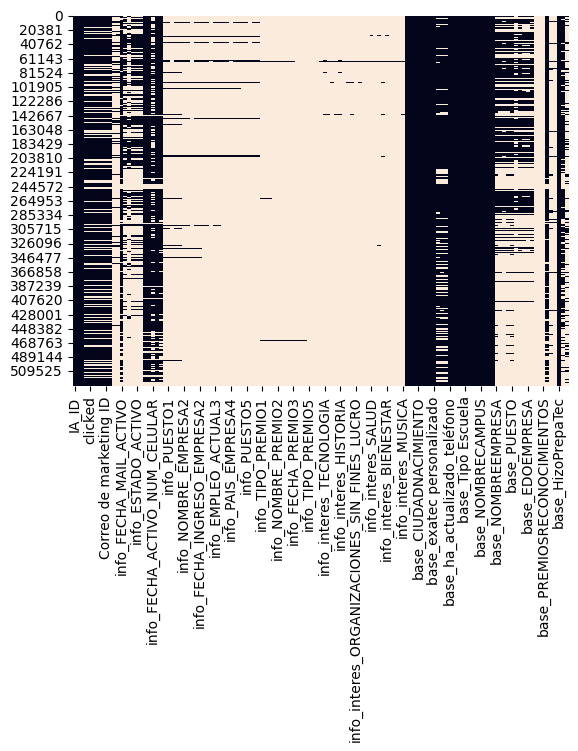

In [54]:
#Usaremos un mapa de calor para tenerlo más visual
sns.heatmap(df_unido.isnull(), cbar=False)
plt.show()

En el archivo existe información histórica laboral
Se puede detectar que los egresados solo insertan información de un puesto de trabajo y empresa. Atributos como:
Nombre_Empresa2,3,4,5
Puesto2,3,4,5
Se encuentran vacíos

Lo mismo sucede con información de Premios definidos por el usuario
En cuanto a Intereses están vacíos:
Bienestar, Salud


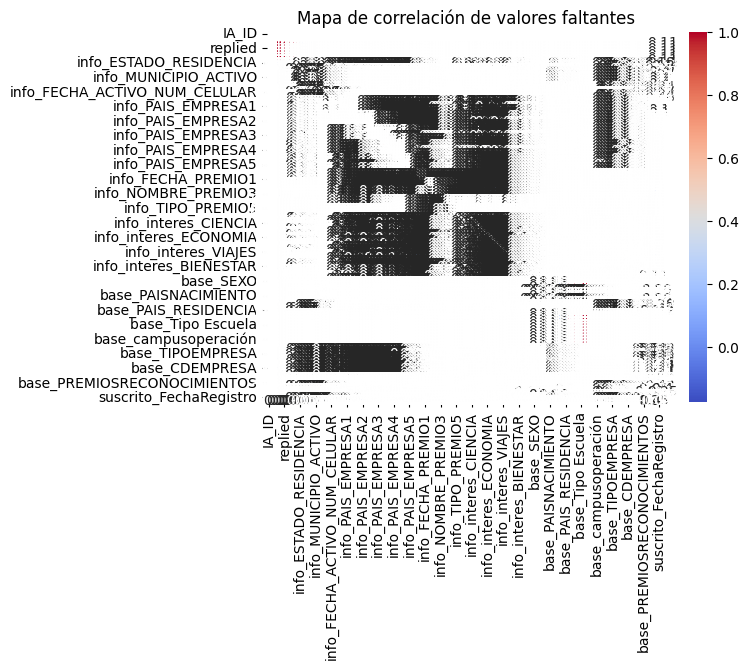

In [55]:
#También es importante revisar la correlación entre atributos, es decir, es comúno que si en una columna falta información en otra también
# Mapa de calor para visualizar la correlación entre valores faltantes
sns.heatmap(df_unido.isnull().corr(), annot=True, cmap='coolwarm')
plt.title("Mapa de correlación de valores faltantes")
plt.show()


In [56]:
#Al existir atributos con mucha información faltante, vemos conveniente hacer una clasificación de columnas según la cantidad de valores faltantes:
#Bajo porcentaje de valores faltantes (<5%)
#Medio (entre 5% y 30%)
#Alto (>30%)

# Clasificación de columnas según la cantidad de valores faltantes
missing_data_classification = pd.DataFrame({
    'Columnas': df_unido.columns,
    'Porcentaje de Faltantes': missing_data_percent
})

# Filtrar columnas según niveles de valores faltantes
bajo_faltantes = missing_data_classification[missing_data_classification['Porcentaje de Faltantes'] < 5]
medio_faltantes = missing_data_classification[(missing_data_classification['Porcentaje de Faltantes'] >= 5) & (missing_data_classification['Porcentaje de Faltantes'] < 30)]
alto_faltantes = missing_data_classification[missing_data_classification['Porcentaje de Faltantes'] >= 30]

print("Columnas con bajo porcentaje de faltantes (<5%):\n", bajo_faltantes)
print("Columnas con porcentaje moderado de faltantes (5%-30%):\n", medio_faltantes)
print("Columnas con alto porcentaje de faltantes (>30%):\n", alto_faltantes)


Columnas con bajo porcentaje de faltantes (<5%):
                                                   Columnas  \
IA_ID                                                IA_ID   
contactable_dominio_correo      contactable_dominio_correo   
contactable_estatus                    contactable_estatus   
base_SEXO                                        base_SEXO   
base_año nac                                  base_año nac   
base_NACIONALIDAD                        base_NACIONALIDAD   
base_CIUDADNACIMIENTO                base_CIUDADNACIMIENTO   
base_ESTADONACIMIENTO                base_ESTADONACIMIENTO   
base_PAISNACIMIENTO                    base_PAISNACIMIENTO   
base_NOCONTACTAR                          base_NOCONTACTAR   
base_exatec personalizado        base_exatec personalizado   
base_ha_actualizado_teléfono  base_ha_actualizado_teléfono   
base_FECHAGRADUACION                  base_FECHAGRADUACION   
base_AñoGrad                                  base_AñoGrad   
base_PROGRAMAACADEMI

## **Respuesta a la pregunta 1:**

* **Sí, existen valores faltantes en el conjunto de datos**. Se identificaron valores faltantes en múltiples columnas, con algunas de ellas superando el 80% de ausencia. Las principales columnas afectadas son base_PREMIOSRECONOCIMIENTOS, base_ASOCIACIONES y base_INTERESES.

* **Visualización de patrones de datos faltantes**: Se utilizaron mapas de calor para visualizar la ausencia de valores, mostrando una correlación significativa entre algunas columnas de información adicional, como los campos de premios y asociaciones.

* **Clasificación de columnas**: Las columnas se clasificaron según el porcentaje de valores faltantes, permitiendo una priorización efectiva para el tratamiento de datos. La mayoría de las columnas con alto porcentaje de faltantes corresponden a información opcional proporcionada por los egresados (ej: premios adicionales y asociaciones).

* **Posibles patrones de ausencia**: En el análisis se observó que los egresados solo tienden a proporcionar información de su empleo actual y un premio principal, dejando otros campos como Puesto2, Nombre_Empresa2 y info_FECHA_PREMIO2 sin datos.

* **Sugerencia para siguientes pasos:** Dado que algunas columnas tienen más de 80% de valores faltantes, es recomendable considerar su eliminación o imputación basada en el promedio de las observaciones existentes, dependiendo de la importancia de la variable para el modelo.

# **Pregunta 2: ¿Cuáles son las estadísticas resumidas del conjunto de datos?**



In [57]:
print(df_unido.describe(include='all'))  # Muestra estadísticas resumidas de todas las columnas

                IA_ID contactable_dominio_correo contactable_estatus  \
count   529888.000000                     529888              529888   
unique            NaN                       7769                   2   
top               NaN                  gmail.com      Ciclo Anterior   
freq              NaN                     232838              489957   
mean    216316.712913                        NaN                 NaN   
std     107232.949370                        NaN                 NaN   
min          6.000000                        NaN                 NaN   
25%     131724.000000                        NaN                 NaN   
50%     223325.500000                        NaN                 NaN   
75%     311383.000000                        NaN                 NaN   
max     370520.000000                        NaN                 NaN   

               opened        clicked   replied  \
count   401922.000000  401922.000000  401922.0   
unique            NaN            Na

In [58]:
#Calcular estadísticas avanzadas para variables numéricas

# Estadísticas avanzadas para las variables numéricas
numeric_stats = df_unido.describe().transpose()

# Calcular skewness (asimetría)
numeric_stats['Skewness'] = df_unido.select_dtypes(include=[np.number]).skew()

# Calcular el coeficiente de variación (CV = std/mean)
numeric_stats['Coeficiente de Variación'] = numeric_stats['std'] / numeric_stats['mean']

print(numeric_stats)



                           count          mean           std           min  \
IA_ID                   529888.0  2.163167e+05  1.072329e+05  6.000000e+00   
opened                  401922.0  1.641373e+00  1.238329e+00  1.000000e+00   
clicked                 401922.0  7.835102e-02  3.923517e-01  0.000000e+00   
replied                 401922.0  0.000000e+00  0.000000e+00  0.000000e+00   
Contacto ID             401922.0  4.014827e+09  1.123183e+10  2.680100e+04   
Correo de marketing ID  401922.0  3.543166e+11  3.827993e+10  2.292888e+09   
info_FECHA_PREMIO1        4193.0  2.011782e+03  7.772658e+01  0.000000e+00   
info_FECHA_PREMIO2        1757.0  2.013536e+03  7.618353e+00  1.976000e+03   
info_FECHA_PREMIO3         931.0  2.013261e+03  6.635322e+00  1.986000e+03   
info_FECHA_PREMIO4         355.0  2.013220e+03  7.991320e+00  1.983000e+03   
info_FECHA_PREMIO5         205.0  2.013229e+03  6.740361e+00  1.993000e+03   
base_NIVELACADEMICO     529877.0  5.669652e+00  1.337980e+00  2.

In [59]:
#Resumir las estadísticas de variables categóricas
for col in df_unido.select_dtypes(include=['object']).columns:
    print(f"Columna '{col}':\n")
    print(df_unido[col].value_counts(normalize=True) * 100)  # Frecuencia relativa (%)
    print("\n" + "-"*50 + "\n")


Columna 'contactable_dominio_correo':

contactable_dominio_correo
gmail.com          43.940984
hotmail.com        16.092080
tec.mx             11.477331
exatec.tec.mx      10.395970
itesm.mx            3.248611
                     ...    
migrare.ca          0.000189
ifasoc.com          0.000189
logicsite.com       0.000189
wfour.mx            0.000189
versatil-ti.com     0.000189
Name: proportion, Length: 7769, dtype: float64

--------------------------------------------------

Columna 'contactable_estatus':

contactable_estatus
Ciclo Anterior    92.464257
Ciclo Actual       7.535743
Name: proportion, dtype: float64

--------------------------------------------------

Columna 'object_id':

object_id
803bdf02-4979-4522-9940-8f0bda3eec3e    0.009952
425485bc-0dfc-4ef7-9a01-bb3525cc97f3    0.009952
3594b0ff-1462-4569-91ba-e601be4d44ab    0.009952
edc8cc56-8641-4272-8119-5b3b3069d9e5    0.009952
51c1aefb-489a-45f4-ab47-fea4c9120a4b    0.009952
                                          ..

## **Análisis:**

**Variables numéricas**
Las estadísticas resumidas para las variables numéricas fueron calculadas utilizando el método describe() de pandas, complementado con métricas avanzadas como skewness (asimetría) y el coeficiente de variación. Estas métricas nos permiten entender la distribución y variabilidad de las variables, y determinar si es necesario aplicar transformaciones adicionales para corregir distribuciones sesgadas.

**Observaciones**
* **opened**: Tiene un sesgo altamente positivo de 6.95, lo que indica que la mayoría de los valores son bajos. El coeficiente de variación es 0.75, lo cual sugiere una gran variación respecto a la media.
* **clicked**: Muestra un sesgo positivo aún mayor de 11.18, que nos dice que existe una una distribución muy asimétrica. El coeficiente de variación es 5.00, indicando que la mayoría de los registros no tienen clicks
* **Fechas de premios (info_FECHA_PREMIO1 a info_FECHA_PREMIO5)**: Presentan un sesgo negativo considerable, lo que indica que la mayoría de los premios se concentran en años recientes. Veremos con el equipo de egresados cuándo inicia el histórico de premios o es una iniciativa nueva.
* **Correo de marketing ID**: Tiene un sesgo negativo alto de -6.06.
base_NIVELACADEMICO: La variable presenta variación relativa baja (coeficiente de variación de 0.23) y un sesgo positivo de 1.96, podríamos asumir que existe concentración de valores en niveles académicos más bajos.


**Variables categóricas**
Las estadísticas para las variables categóricas se calcularon con value_counts() y se presentaron como frecuencias relativas (% de cada categoría). Esto permitió identificar la proporción de cada categoría en relación con el total.

**Observaciones**
* **contactable_dominio_correo**: La mayoría de los correos pertenecen a dominios como gmail.com (43.94%), hotmail.com (16.09%) y tec.mx (11.48%). El resto se distribuye en más de 7,769 dominios diferentes.
* **contactable_estatus**: La mayoría de los registros están clasificados como Ciclo Anterior (92.46%), con solo el 7.53% en Ciclo Actual. Revisaremos con el egresados esto posiblemente es porque se encuentran en "inicio de ciclo".
* **base_SEXO**: Hay un mayor número de hombres (60.89%) que de mujeres (39.10%).
* **base_NACIONALIDAD**: Predominantemente Mexicana (95.91%), seguida por Colombiana (0.75%) y Ecuatoriana (0.59%). Las otras nacionalidades tienen una representación mínima.
* **Intereses (info_interes_*)**: Todas las columnas de intereses (info_interes_EDUCACION, info_interes_TECNOLOGIA, etc.) tienen un 100% de Sí, lo que sugiere que todos los registros tienen el mismo valor, lo cual puede no ser informativo.

**Identificación de patrones**
Se observó una alta concentración de valores en ciertos dominios de correo y en el estado de residencia (Nuevo León y Ciudad de México). Además, las variables relacionadas con premios y reconocimientos mostraron distribuciones sesgadas hacia premios recientes.

**Distribuciones sesgadas**: Las variables numéricas como opened y clicked presentaron un alto sesgo positivo, mientras que variables de fechas como info_FECHA_PREMIO1 mostraron sesgo negativo. Aplicaremos transformaciones logarítmicas para las variables con sesgo positivo y posiblemente Box-Cox para las variables con sesgo negativo

**Siguientes pasos para tratamiento de datos**
Dado que algunas variables tienen alta dispersión y sesgo, aplicaremos algunas transformaciones como:
* **Transformación logarítmica**: Para variables como opened y clicked para reducir el sesgo positivo.
* **Transformación Box-Cox**: Para las variables de fecha como info_FECHA_PREMIO1, que tienen un sesgo negativo.
* **Normalización y estandarización**: Para las variables de identificación (Contacto ID y Correo de marketing ID), dado que presentan valores extremos y alto coeficiente de variación.

**Análisis de valores faltantes y patrones de ausencia**
En esta etapa del análisis, se complementó el análisis estadístico con un mapa de calor de valores faltantes, mostrando que ciertas columnas como info_FECHA_PREMIO3, info_NOMBRE_PREMIO2, info_NOMBRE_EMPRESA2, y otras tienen más de 80% de datos faltantes, lo cual sugiere que se debe decidir entre eliminar estas columnas o usar técnicas de imputación más avanzadas.

**Conclusión** El análisis estadístico ha permitido identificar características clave del conjunto de datos, como la existencia de distribuciones sesgadas, alta variabilidad en ciertas columnas y patrones de ausencia significativos. Las técnicas de visualización y métricas adicionales sugieren que se deben aplicar transformaciones y normalizaciones antes de proceder con un análisis más profundo.

# **Pregunta 3: ¿Hay valores atípicos en el conjunto de datos?**

Los valores atípicos son puntos de datos que se alejan significativamente del resto de las observaciones y pueden distorsionar análisis estadísticos, regresiones o modelos predictivos. Identificarlos nos ayudará a decidir si se deben eliminar, transformar o estudiar más a fondo.

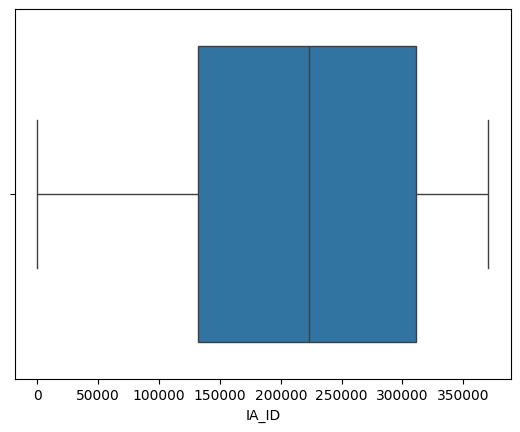

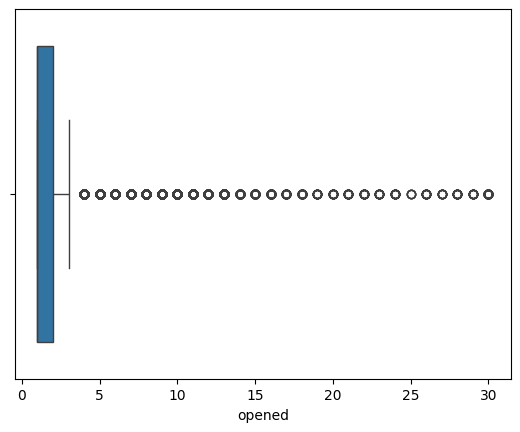

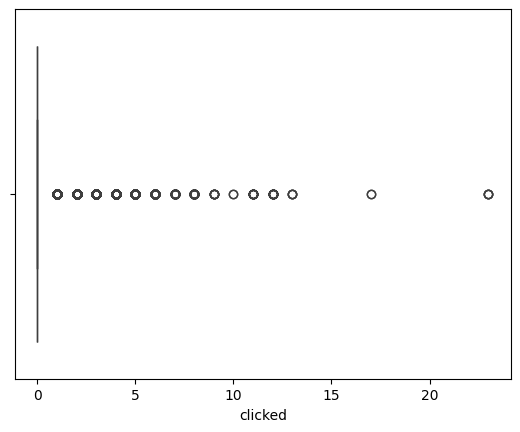

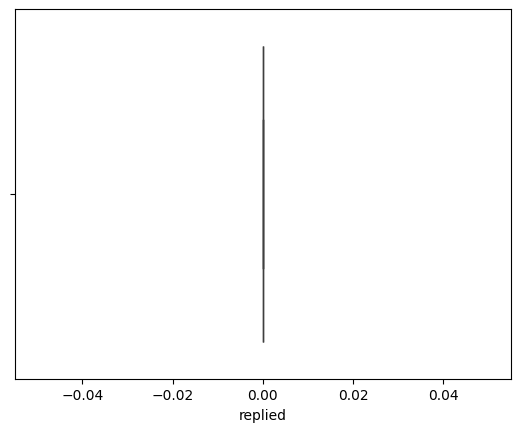

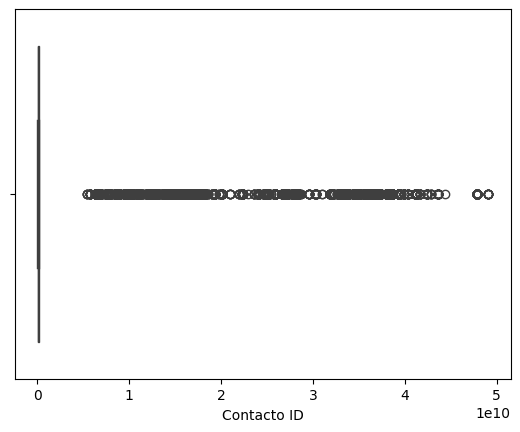

...

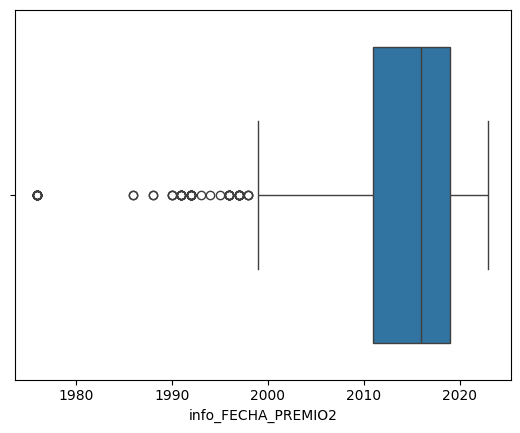

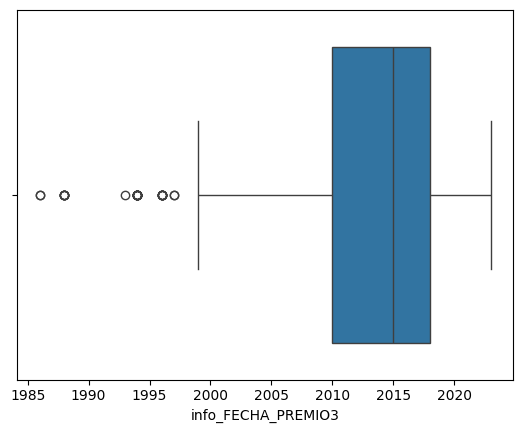

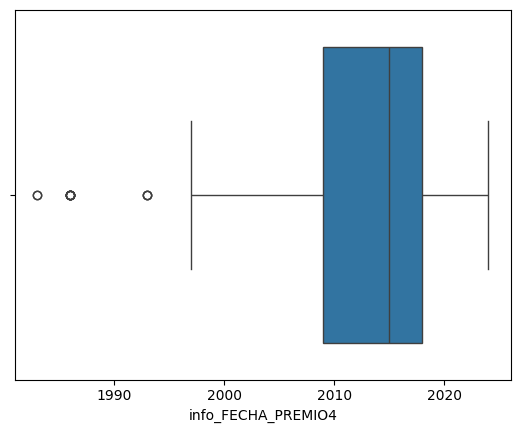

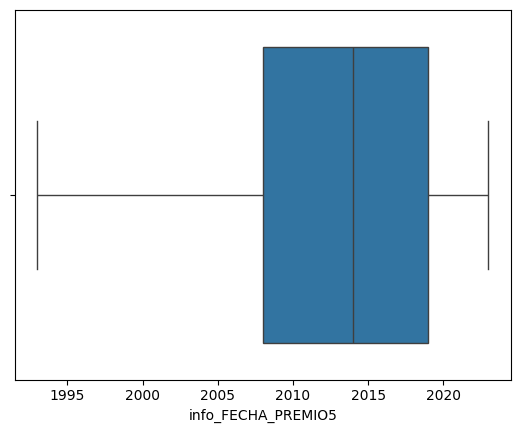

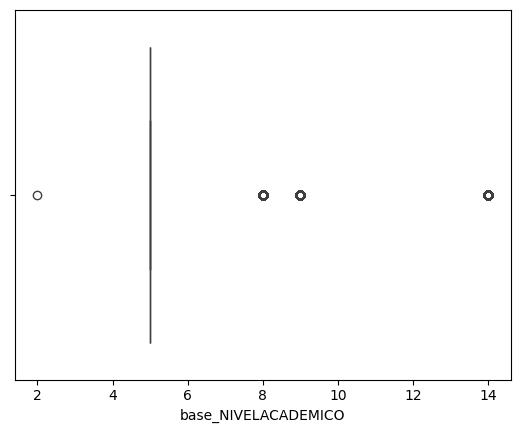

In [60]:
#Identificar valores atípicos con boxplots:

#for column in df_unido.select_dtypes(include=[np.number]).columns:
 #   sns.boxplot(x=df_unido[column])
  #  plt.show()

for column in df_unido.select_dtypes(include=[np.number]).columns:
    if not df_unido[column].empty:
        try:
            sns.boxplot(x=df_unido[column])
            plt.show()
        except ValueError:
            print(f"No se grafica la columna: {column} ya que no es un valor numérico o válido.")

Análisis

In [61]:
#Usar el rango intercuartílico (IQR) Para identificar los valores atípicos numéricos.

Q1 = df_unido.select_dtypes(include=[np.number]).quantile(0.25)
Q3 = df_unido.select_dtypes(include=[np.number]).quantile(0.75)
IQR = Q3 - Q1

df_unido_numeric = df_unido.select_dtypes(include=[np.number])
outliers = ((df_unido_numeric < (Q1 - 1.5 * IQR)) | (df_unido_numeric > (Q3 + 1.5 * IQR))).sum()
print(outliers)

#Q1 = df_unido.quantile(0.25)
#Q3 = df_unido.quantile(0.75)
#IQR = Q3 - Q1

#outliers = ((df_unido < (Q1 - 1.5 * IQR)) | (df_unido > (Q3 + 1.5 * IQR))).sum()
#print(outliers)


IA_ID                          0
opened                     19794
clicked                    23483
replied                        0
Contacto ID                44562
Correo de marketing ID     11123
info_FECHA_PREMIO1           243
info_FECHA_PREMIO2            73
info_FECHA_PREMIO3            35
info_FECHA_PREMIO4            13
info_FECHA_PREMIO5             0
base_NIVELACADEMICO       112895
dtype: int64


**Descripción de los métodos utilizados**

**Boxplot**: No ayudó a resaltar visualmente los valores atípicos como puntos fuera del rango esperado (por encima o debajo de los bigotes).

**IQR**: Cualquier valor por debajo de
𝑄
1
−
1.5
×
𝐼
𝑄
𝑅
Q1−1.5×IQR o por encima de
𝑄
3
+
1.5
×
𝐼
𝑄
𝑅
Q3+1.5×IQR se considera un valor atípico.

In [62]:
#Queremos resaltar qué variables pueden necesitar atención especial y si estos valores atípicos tienen un patrón o están distribuidos aleatoriamente.
outlier_summary = pd.DataFrame({'Column': df_unido_numeric.columns, 'Outliers': outliers})
display(outlier_summary)


,Column,Outliers
IA_ID,IA_ID,0
opened,opened,19794
clicked,clicked,23483
replied,replied,0
Contacto ID,Contacto ID,44562
Correo de marketing ID,Correo de marketing ID,11123
info_FECHA_PREMIO1,info_FECHA_PREMIO1,243
info_FECHA_PREMIO2,info_FECHA_PREMIO2,73
info_FECHA_PREMIO3,info_FECHA_PREMIO3,35
info_FECHA_PREMIO4,info_FECHA_PREMIO4,13


**Recomendaciones para el tratamiento de valores atípicos**
*Eliminación de valores atípicos si se considera que son errores o datos inusuales.
* Transformación usando logaritmos o transformaciones de Box-Cox si los datos están sesgados.
* Imputación con la mediana o con valores calculados basados en otras variables para mantener la integridad del conjunto de datos.

**Conclusión de la pregunta:**
Para identificar los valores atípicos en el conjunto de datos, se realizaron dos análisis principales: un análisis visual con boxplots y un análisis estadístico utilizando el rango intercuartílico (IQR).

Se encontró que las columnas 'opened' y 'clicked' presentan un número significativo de valores atípicos, posiblemente debido a la distribución sesgada de estos valores. Estos valores podrían ser estudiados para determinar si se deben eliminar, transformar o mantener como casos especiales. Adicionalmente, se podría utilizar un análisis visual complementario con histogramas para observar mejor la dispersión de estos valores y su impacto en el análisis general

# **Pregunta 4: ¿Cuál es la cardinalidad de las variables categóricas?**



In [63]:
#Obtener el número de categorías únicas en las columnas categóricas
for col in df_unido.select_dtypes(include=['object']).columns:
    print(f"{col}: {df_unido[col].nunique()} categorías")


contactable_dominio_correo: 7769 categorías
contactable_estatus: 2 categorías
object_id: 208202 categorías
Campaña ID: 11 categorías
info_ESTADO_RESIDENCIA: 146 categorías
info_PAIS_RESIDENCIA: 90 categorías
info_FECHA_MAIL_ACTIVO: 5976 categorías
info_TIPO_DOMICILIO: 1 categorías
info_POBLACION_ACTIVO: 1107 categorías
info_MUNICIPIO_ACTIVO: 566 categorías
info_ESTADO_ACTIVO: 146 categorías
info_PAIS_ACTIVO: 34 categorías
info_FECHA_ACTIVO: 8082 categorías
info_NUMERO_CELULAR: 2 categorías
info_FECHA_ACTIVO_NUM_CELULAR: 6670 categorías
info_SOCIAL_LINKEDIN: 2 categorías
info_ESTADOCIVIL: 7 categorías
info_NOMBRE_EMPRESA1: 4421 categorías
info_PUESTO1: 4099 categorías
info_PAIS_EMPRESA1: 56 categorías
info_EMPLEO_ACTUAL1: 2 categorías
info_FECHA_INGRESO_EMPRESA1: 2070 categorías
info_NOMBRE_EMPRESA2: 3005 categorías
info_PUESTO2: 2803 categorías
info_PAIS_EMPRESA2: 46 categorías
info_EMPLEO_ACTUAL2: 2 categorías
info_FECHA_INGRESO_EMPRESA2: 1382 categorías
info_NOMBRE_EMPRESA3: 2120 cat

## **Análisis**:
Esta pregunta nos ayuda a revisar los catálogos que existen

In [64]:
# Mostrar los valores únicos de todas las columnas categóricas de nuestra base
for col in df_unido.select_dtypes(include=['object']).columns:
    print(f"Columna '{col}':")
    print(df_unido[col].unique())  # Muestra los valores únicos
    print("\n" + "-"*50 + "\n")  # Separador para mejorar la legibilidad


Columna 'contactable_dominio_correo':
['itesm.mx' 'gmail.com' 'grupoceres.com.mx' ... 'sip.cl' 'nytesa.com.mx'
 'simbiosys.com.mx']

--------------------------------------------------

Columna 'contactable_estatus':
['Ciclo Anterior' 'Ciclo Actual']

--------------------------------------------------

Columna 'object_id':
[nan '82ede0a1-0076-4aeb-b540-ffd598a33e6b'
 '7508a1ed-2608-41ce-80a9-a47cddcfdd23' ...
 '0e5d614a-d627-412d-a422-5a88cb7ff738'
 'a6848f3e-f41f-4607-be29-ca252215b559'
 'c00d45f7-c59a-4665-a5fb-f745a587afa3']

--------------------------------------------------

Columna 'Campaña ID':
[nan '10949903422' '2.06465E+11' '19343712904' '23415413809' '2.77422E+11'
 '33875857906' '1.20817E+11' '3.43993E+11' '(Sin valor)' '1.20843E+11'
 '2.82747E+11']

--------------------------------------------------

Columna 'info_ESTADO_RESIDENCIA':
[nan 'Sinaloa' 'Nuevo León' 'San Luis Potosí' 'Yucatán' 'Coahuila'
 'Ciudad de México' 'Jalisco' 'Oaxaca' 'Tamaulipas' 'Guanajuato'
 'Estado de

In [65]:
#En este código trataremos de hacer más visual la información de los catálogos

# Crear una lista para almacenar los resultados
resultados = []

# Obtener los valores únicos de cada columna categórica
for col in df_unido.select_dtypes(include=['object']).columns:
    valores_unicos = df_unido[col].unique()
    num_valores = len(valores_unicos)

    # Si hay más de 10 valores únicos, mostrar solo los primeros 10
   #if num_valores > 10:
        #valores_mostrados = ", ".join(map(str, valores_unicos[:10])) + "..."
    #else:
    valores_mostrados = ", ".join(map(str, valores_unicos))

    # Agregar la columna, cantidad de categorías y los valores únicos (limitados a 10 si es el caso)
    resultados.append([col, num_valores, valores_mostrados])

# Crear un DataFrame con los resultados
df_resultados = pd.DataFrame(resultados, columns=['Columna', 'Número de Categorías', 'Valores Únicos (primeros 10)'])

# Mostrar la tabla resultante
from IPython.display import display
display(df_resultados)


,Columna,Número de Categorías,Valores Únicos (primeros 10)
0,contactable_dominio_correo,7769,"itesm.mx, gmail.com, grupoceres.com.mx, yahoo...."
1,contactable_estatus,2,"Ciclo Anterior, Ciclo Actual"
2,object_id,208203,"nan, 82ede0a1-0076-4aeb-b540-ffd598a33e6b, 750..."
3,Campaña ID,12,"nan, 10949903422, 2.06465E+11, 19343712904, 23..."
4,info_ESTADO_RESIDENCIA,147,"nan, Sinaloa, Nuevo León, San Luis Potosí, Yuc..."
...,...,...,...
110,base_INTERESES,943,"nan, , Networking, Bienestar Integral, Lidera..."
111,base_updatedata,3,"nan, 45307,"
112,base_HizoPrepaTec,3,"No, nan, Sí"
113,suscrito_FechaRegistro,1332,"10/09/2020 14:25, nan, 30/06/2022 12:47, 10/09..."


<ipython-input-66-dc4fb809505d>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cardinalidad.values, y=cardinalidad.index, palette='viridis')


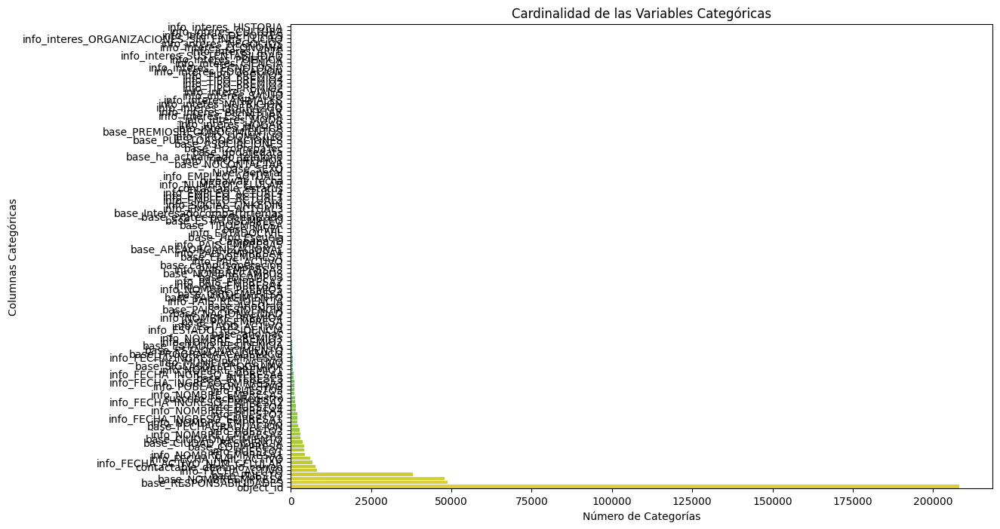

In [66]:
#Cardinalidaed visual
# Obtener el número de categorías para cada columna categórica
cardinalidad = df_unido.select_dtypes(include=['object']).nunique().sort_values()

# Crear gráfico de barras
plt.figure(figsize=(12, 8))
sns.barplot(x=cardinalidad.values, y=cardinalidad.index, palette='viridis')
plt.title("Cardinalidad de las Variables Categóricas")
plt.xlabel("Número de Categorías")
plt.ylabel("Columnas Categóricas")
plt.show()


Existen atributos con más de 100 categorías, esto puede afectar el rendimiento del modelo o dificultar su interpretación.

Para estas columnas evaluaremos la opción de agrupar categorías similares o reducir la cardinalidad mediante técnicas como el one-hot encoding limitado o target encoding

In [67]:
# Calcular proporción de categorías únicas respecto al total de registros
total_registros = len(df_unido)
proporciones = (df_unido.select_dtypes(include=['object']).nunique() / total_registros) * 100
print(proporciones)


contactable_dominio_correo     1.466159
contactable_estatus            0.000377
object_id                     39.291699
Campaña ID                     0.002076
info_ESTADO_RESIDENCIA         0.027553
                                ...    
base_INTERESES                 0.177773
base_updatedata                0.000377
base_HizoPrepaTec              0.000377
suscrito_FechaRegistro         0.251185
giveaway_fecha                 0.000377
Length: 115, dtype: float64


Las variables con 1 sola categoria no aportan información útil para el análisis y podrían ser eliminadas para reducir la dimensionalidad del conjunto de datos

**Transformaciones**
Existen columnas categóricas con cardinalidad muy baja (por ejemplo, columnas binarias o con tres categorías como base_HizoPrepaTec), se aplicarán técnicas como el label encoding en lugar de one-hot encoding para simplificar la codificación y evitar la explosión de variables dummy

Por el contrario en el caso de variables con cardinalidades extremadamente altas (como base_PUESTO o base_RESPONSABILIDADES), evaluaremos los preprocesamientos específicos antes de aplicar modelos. Por ejemplo, en modelos basados en árboles de decisión o redes neuronales, podremos ejecutar prepocesos con embeddings o reducciones de dimensionalidad.


## **Análisis**
Se analizaron todas las columnas categóricas del dataset. Las variables base_PUESTO (38,065 categorías) y base_RESPONSABILIDADES (48,688 categorías) presentan una alta cardinalidad, lo cual puede dificultar el modelado e interpretación. Exploraremos métodos de reducción de dimensionalidad como la agrupación de categorías menos representativas.

Además, se identificaron variables con solo una categoría (base_ASOCIACIONES, base_PUESTOASOCIACIONES), que podrían ser eliminadas del análisis para evitar redundancia.


# **Pregunta 5: ¿Existen distribuciones sesgadas en el conjunto de datos? ¿Necesitamos aplicar alguna transformación no lineal?**


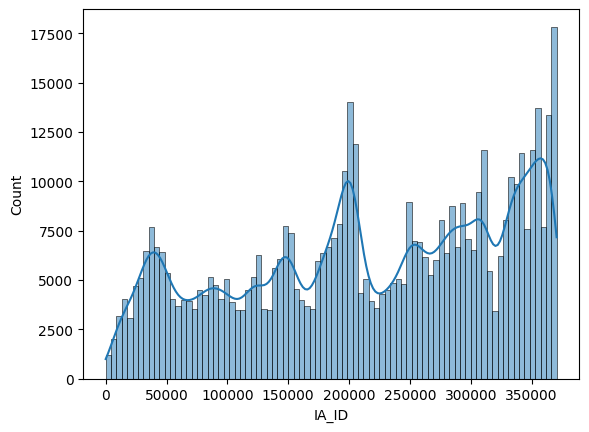

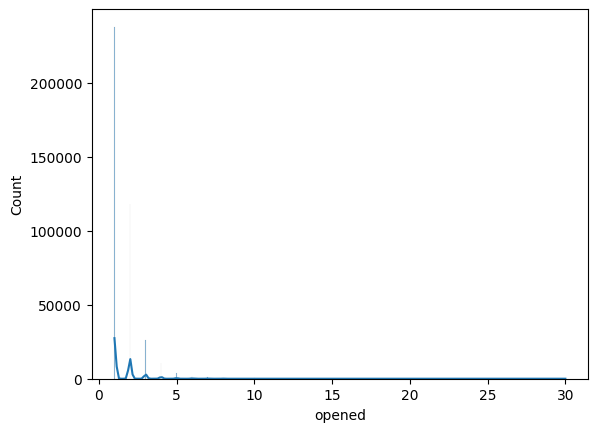

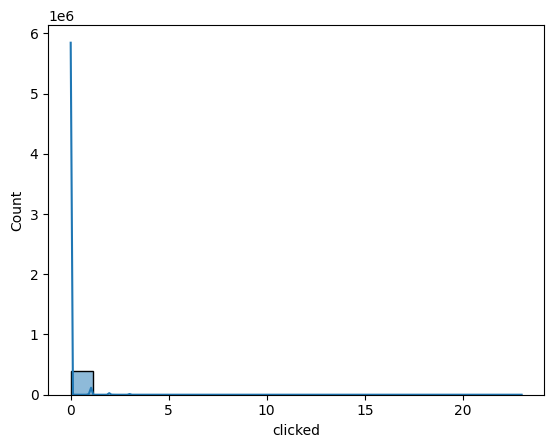

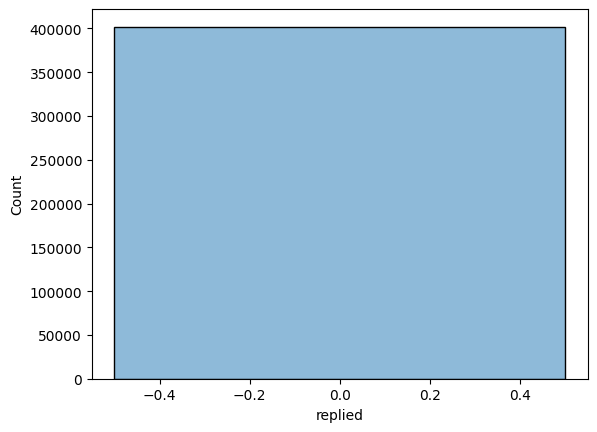

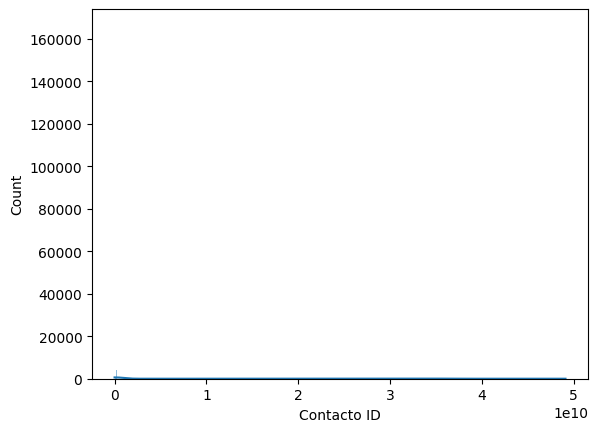

...

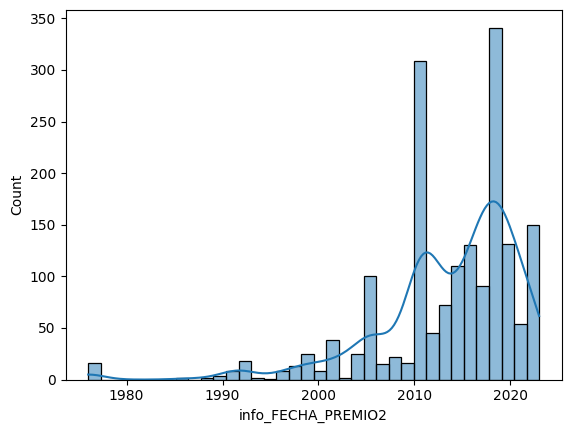

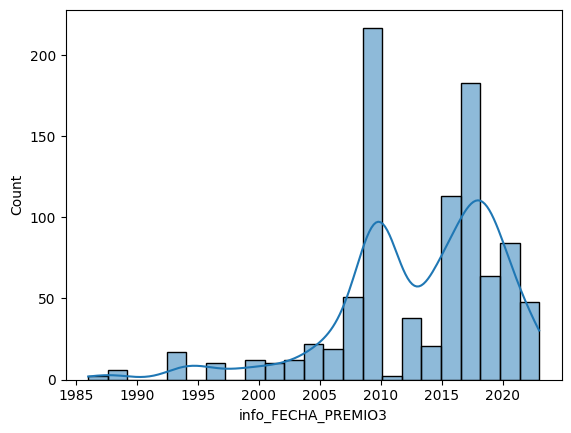

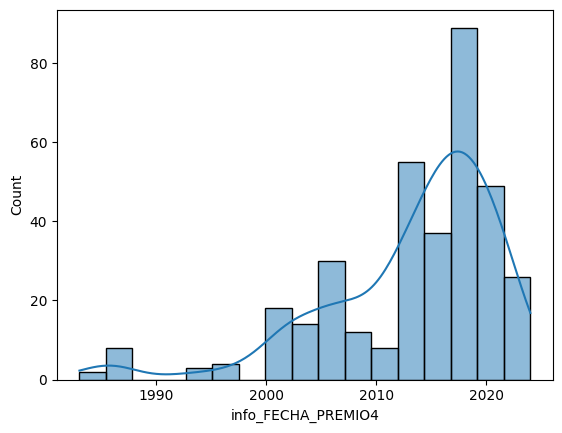

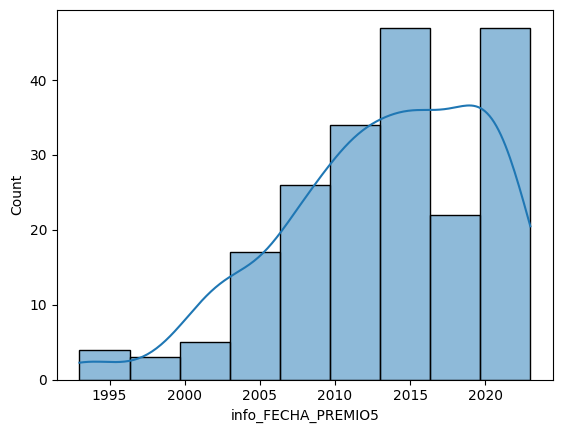

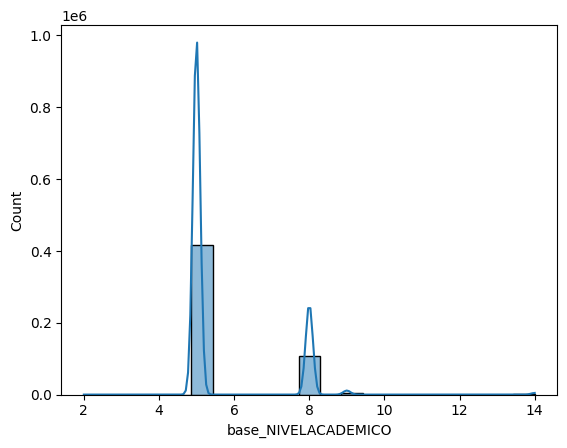

In [68]:
#Visualizar distribuciones: histogramas para ver la distribución de cada columna.
for column in df_unido.select_dtypes(include=[np.number]).columns:
    sns.histplot(df_unido[column], kde=True)
    plt.show()


Análisis pasa saber si hay sesgos y aplicar transformaciones

In [69]:
#Revisaremos si existen sesgos numéricos
for column in df_unido.select_dtypes(include=[np.number]).columns:
    skewness = df_unido[column].skew()
    print(f"Skewness de {column}: {skewness}")

#el valor de skewness ayudará a definir rápidamente el sesgo
#Cercano a 0: La distribución podría tomarse como simétrica.
#Mayor a 0.5: Existe un sesgo positivo (derecha).
#Menor a -0.5: Existe un sesgo negativo (izquierda).

Skewness de IA_ID: -0.29395289755287035
Skewness de opened: 6.952484456334992
Skewness de clicked: 11.176146290315437
Skewness de replied: 0.0
Skewness de Contacto ID: 2.5795394620726886
Skewness de Correo de marketing ID: -6.0579189858343305
Skewness de info_FECHA_PREMIO1: -25.201100310860834
Skewness de info_FECHA_PREMIO2: -1.7976038347075072
Skewness de info_FECHA_PREMIO3: -1.1402700636767358
Skewness de info_FECHA_PREMIO4: -1.4860381866617076
Skewness de info_FECHA_PREMIO5: -0.688539036560732
Skewness de base_NIVELACADEMICO: 1.9650565715756063


**Análisis de resultado**

Variables con sesgo positivo significativo:
*   opened (6.95)
*   clicked (11.17)
*   Contacto ID (2.58)
*   base_NIVELACADEMICO (1.97)

**¿Qué transformación aplicar?**: transformación logarítmica o raíz cuadrada. Esto ayudará a normalizar las distribuciones

Variables con sesgo negativo significativo:
* Correo de marketing ID (-6.05)
* info_FECHA_PREMIO1 (-25.20)
* info_FECHA_PREMIO2 (-1.79)
* info_FECHA_PREMIO3 (-1.14)
* info_FECHA_PREMIO4 (-1.48)

**¿Qué transformación aplicar?**: transformación de Box-Cox o Yeo-Johnson, ya que estas transformaciones pueden manejar el sesgo negativo mejor.

In [70]:
from scipy.stats import skew, kurtosis

for column in df_unido.select_dtypes(include=[np.number]).columns:
    skewness = skew(df_unido[column].dropna())  # Calcular asimetría
    kurt = kurtosis(df_unido[column].dropna())  # Calcular curtosis
    print(f"Variable: {column}, Asimetría (Skewness): {skewness:.2f}, Curtosis: {kurt:.2f}")


Variable: IA_ID, Asimetría (Skewness): -0.29, Curtosis: -1.12
Variable: opened, Asimetría (Skewness): 6.95, Curtosis: 100.19
Variable: clicked, Asimetría (Skewness): 11.18, Curtosis: 276.56
Variable: replied, Asimetría (Skewness): nan, Curtosis: nan
Variable: Contacto ID, Asimetría (Skewness): 2.58, Curtosis: 4.77
Variable: Correo de marketing ID, Asimetría (Skewness): -6.06, Curtosis: 35.66
Variable: info_FECHA_PREMIO1, Asimetría (Skewness): -25.19, Curtosis: 643.81
Variable: info_FECHA_PREMIO2, Asimetría (Skewness): -1.80, Curtosis: 4.97
Variable: info_FECHA_PREMIO3, Asimetría (Skewness): -1.14, Curtosis: 1.75
Variable: info_FECHA_PREMIO4, Asimetría (Skewness): -1.48, Curtosis: 2.43
Variable: info_FECHA_PREMIO5, Asimetría (Skewness): -0.68, Curtosis: -0.01
Variable: base_NIVELACADEMICO, Asimetría (Skewness): 1.97, Curtosis: 4.63


In [71]:
#Transformación logarítmica para sesgo positivo (valores mayores a 0)
df_unido['opened_log'] = np.log1p(df_unido['opened'])  # Log(1 + x)
df_unido['clicked_log'] = np.log1p(df_unido['clicked'])
df_unido['Contacto_ID_log'] = np.log1p(df_unido['Contacto ID'])
df_unido['base_NIVELACADEMICO_log'] = np.log1p(df_unido['base_NIVELACADEMICO'])


In [72]:
#Transformación Yeo-Johnson para sesgo negativo
from sklearn.preprocessing import PowerTransformer

pt = PowerTransformer(method='yeo-johnson')
#df_unido['Correo_marketing_ID_trans'] = pt.fit_transform(df_unido[['Correo de marketing ID']])
#df_unido['info_FECHA_PREMIO1_trans'] = pt.fit_transform(df_unido[['info_FECHA_PREMIO1']])
#df_unido['info_FECHA_PREMIO2_trans'] = pt.fit_transform(df_unido[['info_FECHA_PREMIO2']])
#df_unido['info_FECHA_PREMIO3_trans'] = pt.fit_transform(df_unido[['info_FECHA_PREMIO3']])
#df_unido['info_FECHA_PREMIO4_trans'] = pt.fit_transform(df_unido[['info_FECHA_PREMIO4']])

#El sesgo no se dará en las fechas por el tipo de dato


Asimetría o skewness:
* Positivo (> 1): Distribución sesgada a la derecha.
* Negativo (< -1): Distribución sesgada a la izquierda.
* Entre -1 y 1: Distribución aproximadamente simétrica.

Curtosis:
* Valor alto (>3): Distribución con colas más pesadas de lo normal (leptocúrtica).
* Valor bajo (<3): Distribución con colas más ligeras de lo normal (platicúrtica).

##**Análisis**

El análisis de la distribución de las variables numéricas utilizando las métricas de asimetría (skewness) y curtosis nos dió luz para saber que muchas de las variables en el conjunto de datos presentan distribuciones sesgadas, por lo que es necesario aplicar transformaciones no lineales en ciertos casos para mejorar la calidad del análisis y la efectividad de los futuros modelos predictivos. A continuación se presenta un resumen de los hallazgos:

**Análisis de la asimetría- skewness**

Asimetría positiva: La mayoría de las variables presentan un alto grado de asimetría positiva (valores superiores a 1), lo cual indica que las distribuciones están sesgadas hacia la derecha, con pocos valores extremos en el lado superior:
* opened: Asimetría de 6.95.
* clicked: Asimetría de 11.18.
* Contacto ID: Asimetría de 2.58.
* base_NIVELACADEMICO: Asimetría de 1.97.

Asimetría negativa: Algunas variables presentan asimetría negativa (menor a -1), indicando que están sesgadas hacia la izquierda, con un mayor número de valores elevados:
* info_FECHA_PREMIO1: Asimetría de -25.19, la mayoría de los registros están concentrados en fechas recientes con pocos registros en fechas pasadas.
* Correo de marketing ID: Asimetría de -6.06.

Variables con asimetría cercana a 0: La variable IA_ID tiene una asimetría de -0.29, lo cual indica una distribución relativamente simétrica.

**Análisis de la curtosis**
La curtosis permite identificar la presencia de colas largas o pesadas en la distribución.
Una curtosis muy alta (> 3) indica que la variable tiene colas más pesadas de lo normal (leptocúrtica), mientras que una curtosis baja (< 3) indica colas más ligeras (platicúrtica).

Variables con curtosis alta:
* opened: Curtosis de 100.19.
* clicked: Curtosis de 276.56.
* info_FECHA_PREMIO1: Curtosis de 643.81.

Estas variables tienen distribuciones con valores extremos que se desvían significativamente de la media, lo que puede afectar el desempeño de los modelos de aprendizaje automático.

Transformaciones realizadas
Para las variables con asimetría positiva y alta curtosis (opened, clicked, Contacto ID), se recomienda aplicar transformaciones logarítmicas.
Para las variables con asimetría negativa (info_FECHA_PREMIO1, info_FECHA_PREMIO2), se probará la transformación de Box-Cox.


La variable *replied* presentó valores *nan* para tanto la asimetría como la curtosis, lo que sugiere que esta variable no tiene datos suficientes o tiene valores constantes. Analizaremos eliminarla del dataset

**Conclusión**
La mayoría de las variables numéricas presentan distribuciones altamente sesgadas y con curtosis elevada. Aplicaremos transformaciones no lineales como el logaritmo y Box-Cox antes de proceder con la fase de modelado.
Estas transformaciones ayudarán a estabilizar la varianza, reducir la asimetría y mejorar la capacidad de los algoritmos para detectar patrones en el conjunto de datos.

# **Pregunta 6: ¿Se identifican tendencias temporales? (En caso de que el conjunto incluya una dimensión de tiempo)**


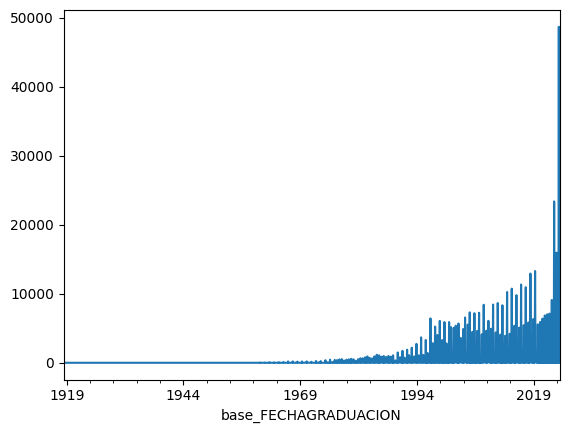

In [73]:
#convertir las columnas de tiempo en tipo datetime
df_unido['base_FECHAGRADUACION'] = pd.to_datetime(df_unido['base_FECHAGRADUACION'], format='%d/%m/%Y', errors='coerce')
#Visualizar tendencias temporales usando gráficos de líneas para ver tendencias a lo largo del tiempo.
df_unido.set_index('base_FECHAGRADUACION').resample('M').count()['IA_ID'].plot() # Select the 'IA_ID' column after resampling and count to plot the trend
plt.show()



<Axes: xlabel='base_AñoGrad'>

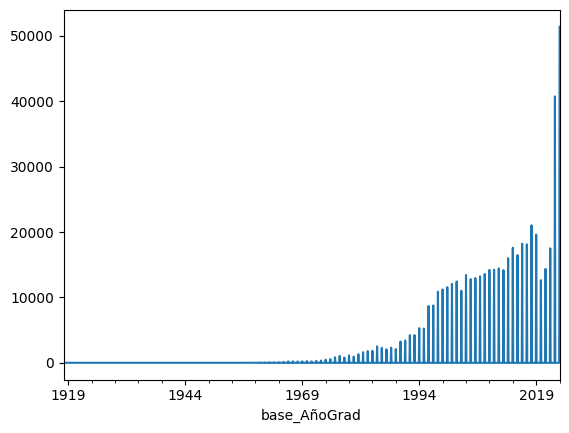

In [74]:
#convertir las columnas de tiempo en tipo datetime
df_unido['base_AñoGrad'] = pd.to_datetime(df_unido['base_AñoGrad'],format='%Y', errors='coerce')
#Visualizar tendencias temporales usando gráficos de líneas para ver tendencias a lo largo del tiempo.
df_unido.set_index('base_AñoGrad').resample('M').count()['IA_ID'].plot() # Select the 'IA_ID' column after resampling and count to plot the trend
#plt.show()

<Axes: xlabel='base_AñoGrad'>

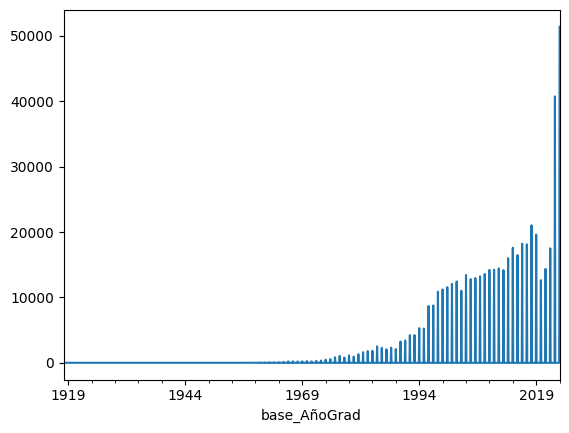

In [75]:
#convertir las columnas de tiempo en tipo datetime
df_unido['base_AñoGrad'] = pd.to_datetime(df_unido['base_AñoGrad'], errors='coerce')
#Visualizar tendencias temporales usando gráficos de líneas para ver tendencias a lo largo del tiempo.
df_unido.set_index('base_AñoGrad').resample('M').count()['IA_ID'].plot() # Select the 'IA_ID' column after resampling and count to plot the trend
#plt.show()

Análisis

# **Pregunta 7: ¿Hay correlación entre las variables dependientes e independientes?**

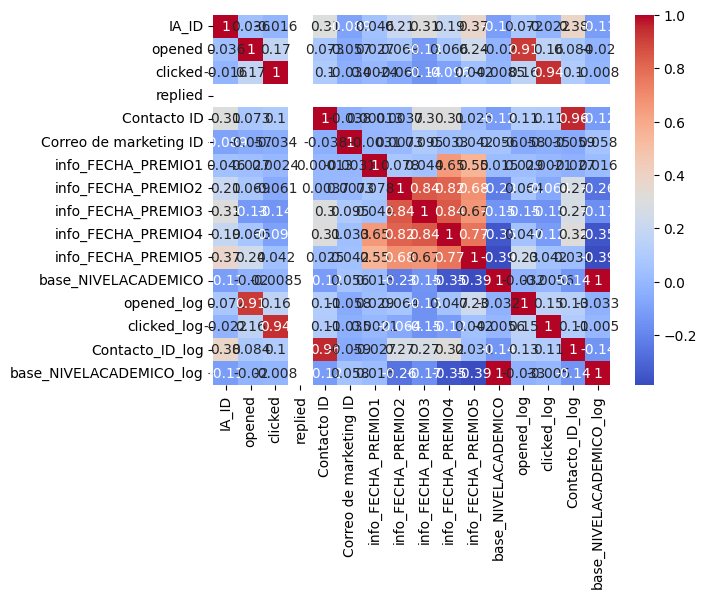

In [76]:
#Matriz de correlación
corr_matrix = df_unido.select_dtypes(include=np.number).corr() # Select only numerical columns for correlation calculation
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


Análisis

# **Pregunta 8: ¿Cómo se distribuyen los datos en función de diferentes categorías?**

In [77]:
# Encontrar las columnas categóricas (de tipo 'object')
categorical_columns = df_unido.select_dtypes(include=['object']).columns

# Mostrar las columnas categóricas
print("Columnas categóricas en df_unido:")
for col in categorical_columns:
    print(col)

Columnas categóricas en df_unido:
contactable_dominio_correo
contactable_estatus
object_id
Campaña ID
info_ESTADO_RESIDENCIA
info_PAIS_RESIDENCIA
info_FECHA_MAIL_ACTIVO
info_TIPO_DOMICILIO
info_POBLACION_ACTIVO
info_MUNICIPIO_ACTIVO
info_ESTADO_ACTIVO
info_PAIS_ACTIVO
info_FECHA_ACTIVO
info_NUMERO_CELULAR
info_FECHA_ACTIVO_NUM_CELULAR
info_SOCIAL_LINKEDIN
info_ESTADOCIVIL
info_NOMBRE_EMPRESA1
info_PUESTO1
info_PAIS_EMPRESA1
info_EMPLEO_ACTUAL1
info_FECHA_INGRESO_EMPRESA1
info_NOMBRE_EMPRESA2
info_PUESTO2
info_PAIS_EMPRESA2
info_EMPLEO_ACTUAL2
info_FECHA_INGRESO_EMPRESA2
info_NOMBRE_EMPRESA3
info_PUESTO3
info_PAIS_EMPRESA3
info_EMPLEO_ACTUAL3
info_FECHA_INGRESO_EMPRESA3
info_NOMBRE_EMPRESA4
info_PUESTO4
info_PAIS_EMPRESA4
info_EMPLEO_ACTUAL4
info_FECHA_INGRESO_EMPRESA4
info_NOMBRE_EMPRESA5
info_PUESTO5
info_PAIS_EMPRESA5
info_EMPLEO_ACTUAL5
info_FECHA_INGRESO_EMPRESA5
info_TIPO_PREMIO1
info_NOMBRE_PREMIO1
info_TIPO_PREMIO2
info_NOMBRE_PREMIO2
info_TIPO_PREMIO3
info_NOMBRE_PREMIO3
info_T

   IA_ID contactable_dominio_correo contactable_estatus  opened  clicked  \
0      6                   itesm.mx      Ciclo Anterior     NaN      NaN   
1     21                  gmail.com      Ciclo Anterior     2.0      0.0   
2     48          grupoceres.com.mx      Ciclo Anterior     4.0      0.0   
3     63               yahoo.com.mx      Ciclo Anterior     NaN      NaN   
4    106                hotmail.com      Ciclo Anterior     NaN      NaN   

   replied                             object_id  Contacto ID  \
0      NaN                                   NaN          NaN   
1      0.0  82ede0a1-0076-4aeb-b540-ffd598a33e6b  224776056.0   
2      0.0  7508a1ed-2608-41ce-80a9-a47cddcfdd23   60136712.0   
3      NaN                                   NaN          NaN   
4      NaN                                   NaN          NaN   

   Correo de marketing ID   Campaña ID  ... base_Interesadocompartirtemas  \
0                     NaN          NaN  ...                                

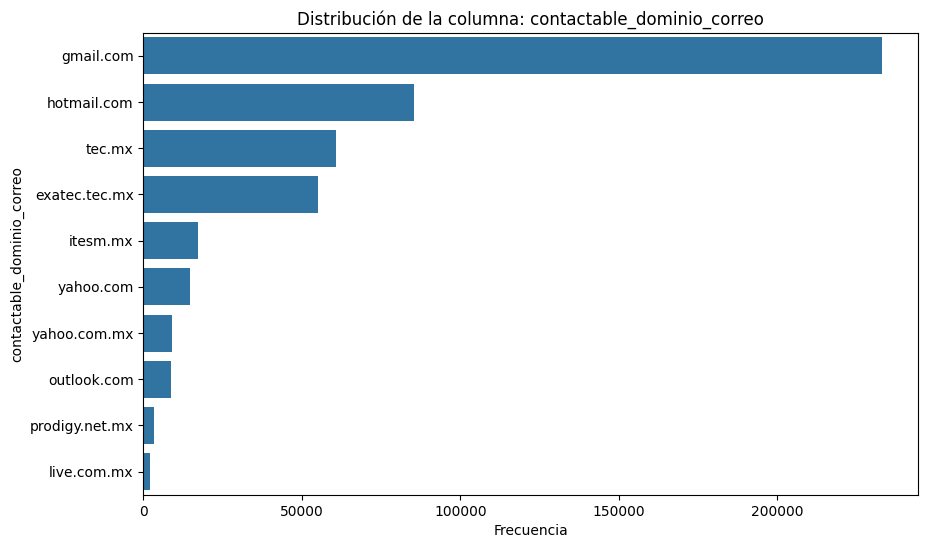

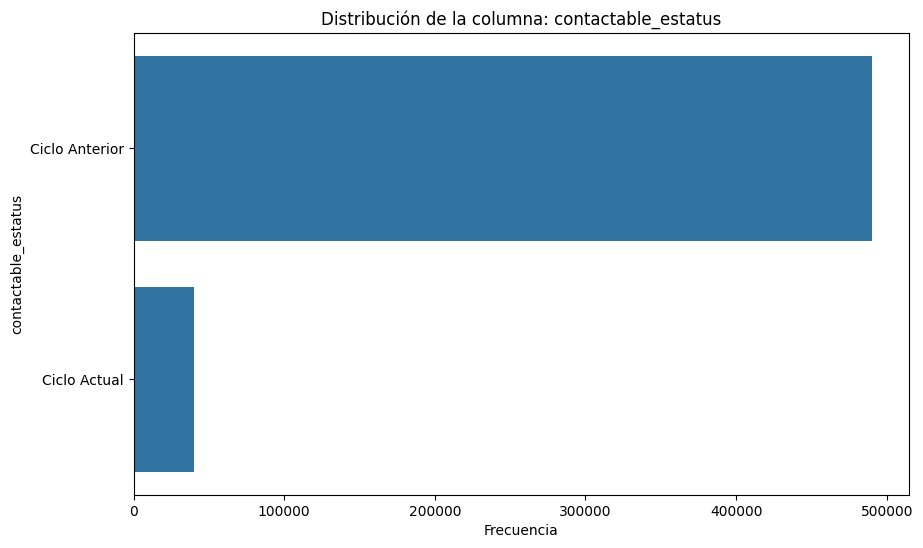

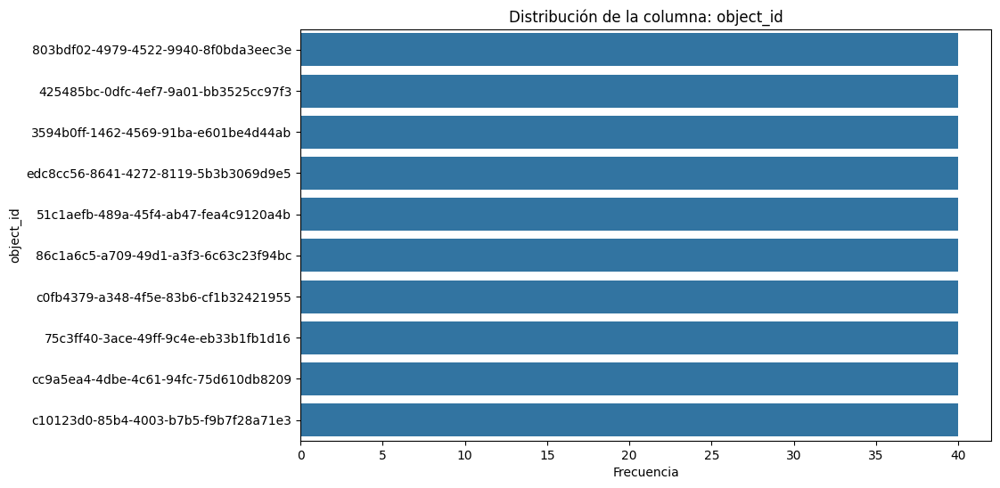

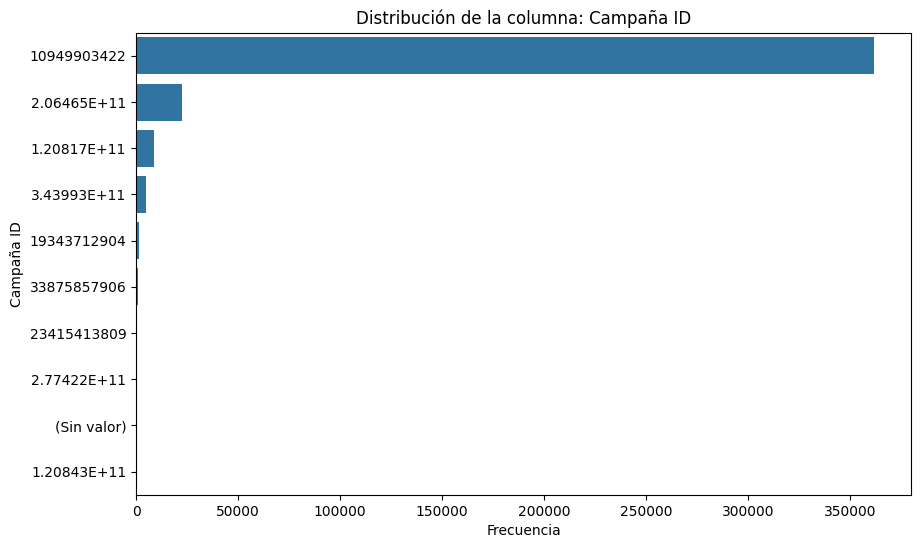

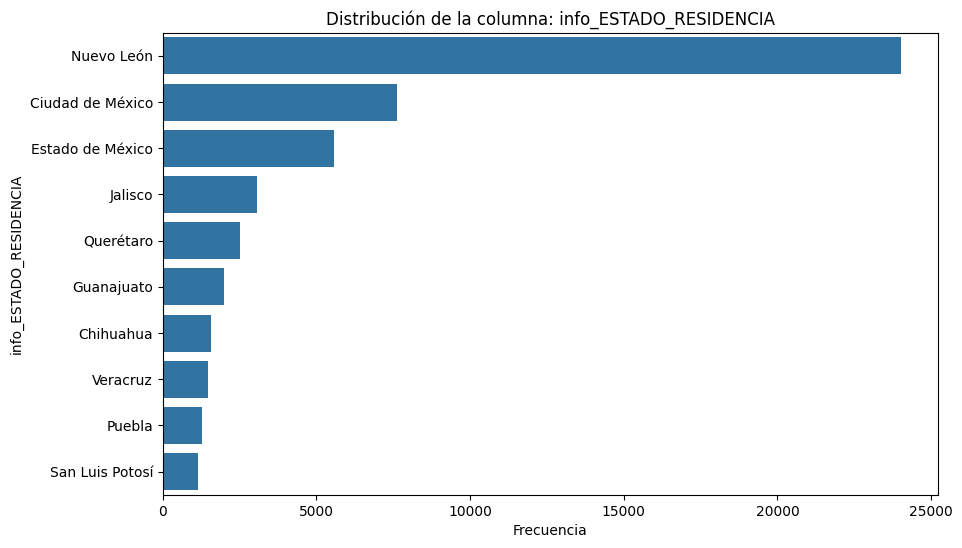

...

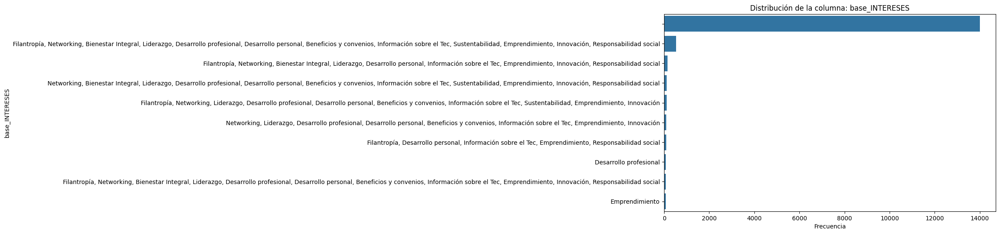

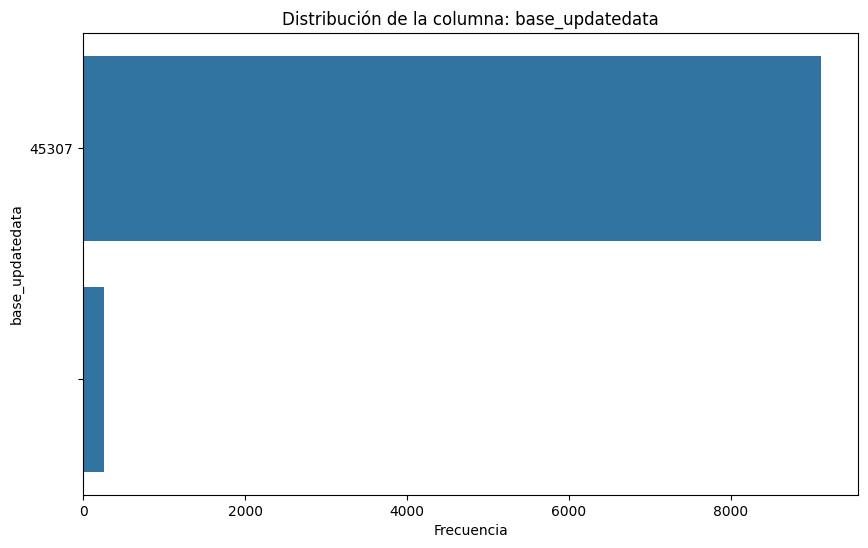

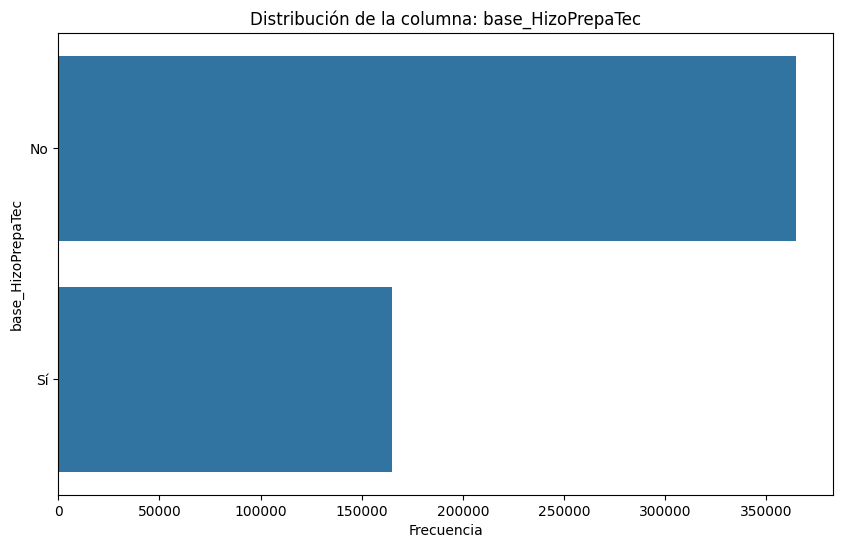

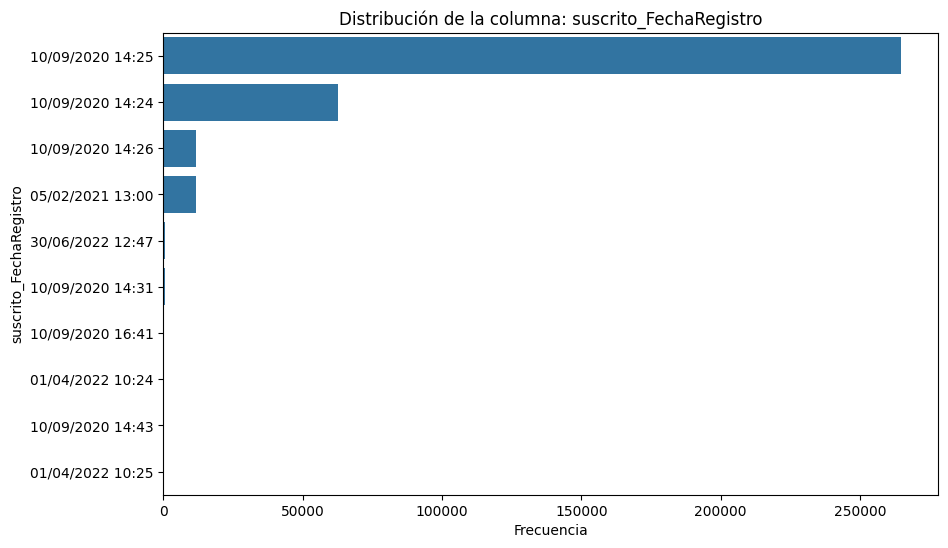

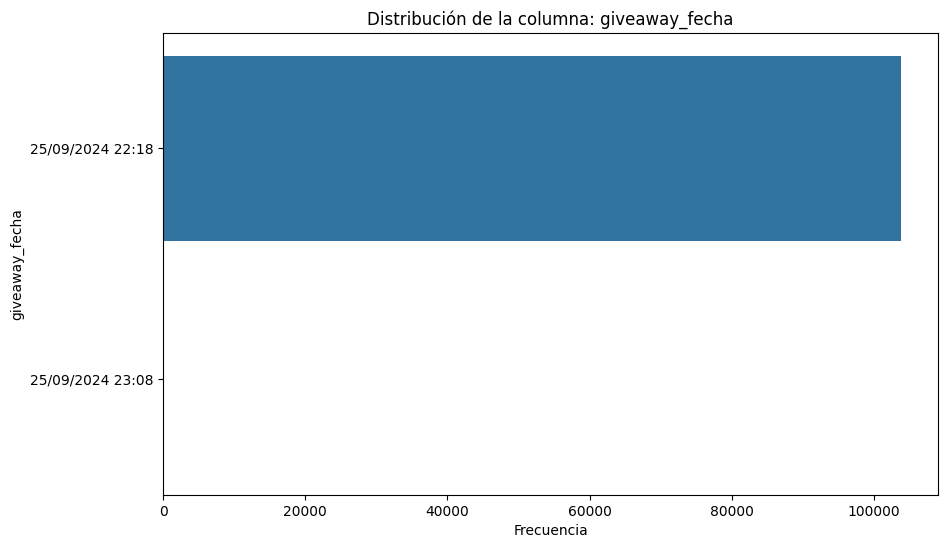

Distribución de la columna 'contactable_dominio_correo':
contactable_dominio_correo
gmail.com          232838
hotmail.com         85270
tec.mx              60817
exatec.tec.mx       55087
itesm.mx            17214
                    ...  
migrare.ca              1
ifasoc.com              1
logicsite.com           1
wfour.mx                1
versatil-ti.com         1
Name: count, Length: 7769, dtype: int64

--------------------------------------------------

Distribución de la columna 'contactable_estatus':
contactable_estatus
Ciclo Anterior    489957
Ciclo Actual       39931
Name: count, dtype: int64

--------------------------------------------------

Distribución de la columna 'object_id':
object_id
803bdf02-4979-4522-9940-8f0bda3eec3e    40
425485bc-0dfc-4ef7-9a01-bb3525cc97f3    40
3594b0ff-1462-4569-91ba-e601be4d44ab    40
edc8cc56-8641-4272-8119-5b3b3069d9e5    40
51c1aefb-489a-45f4-ab47-fea4c9120a4b    40
                                        ..
dd8dd1d1-e86f-44a2-bf4b-d59dfa

In [78]:
# Ver las columnas categóricas
categorical_columns = df_unido.select_dtypes(include=['object']).columns

# Mostrar las primeras filas para asegurarse de que los datos se cargaron correctamente
print(df_unido.head())

# Generar gráficos de barras para cada columna categórica
for col in categorical_columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_unido, y=col, order=df_unido[col].value_counts().index[:10])  # Mostrar el top 10 para columnas con muchas categorías
    plt.title(f'Distribución de la columna: {col}')
    plt.xlabel('Frecuencia')
    plt.ylabel(col)
    plt.show()

# Mostrar una tabla con la distribución de frecuencias de cada columna categórica
for col in categorical_columns:
    print(f"Distribución de la columna '{col}':")
    print(df_unido[col].value_counts())
    print("\n" + "-"*50 + "\n")


# Análisis

## 1. **Distribución Geográfica**
- **info_ESTADO_ACTIVO:**
  - **Nuevo León** tiene la mayor concentración de datos, significativamente superior a cualquier otro estado.
  - Le siguen la **Ciudad de México**, **Estado de México**, **Jalisco**, **Querétaro**, entre otros, aunque en proporciones mucho menores.
  
- **info_PAIS_ACTIVO:**
  - **México** es el país dominante en los datos, con una abrumadora mayoría siendo sede de la mayoria de los campus.
  - En menor proporción, algunos registros están asociados a **Estados Unidos**, seguido por países de América Latina como **Honduras**, **Bolivia**, **Panamá**, y otros.

## 2. **Distribución Temporal**
- **info_FECHA_ACTIVO:**
  - La fecha más común de actividad registrada es **14/08/2022**.
  - Hay picos adicionales en **05/07/2023** y otras fechas en años anteriores, lo que sugiere actividad en varios periodos a lo largo de los años.

- **info_FECHA_ACTIVO_NUM_CELULAR:**
  - La fecha más registrada es **14/10/2019**.
  - También hay una actividad destacada en **04/12/2023** y fechas posteriores como **20/06/2024**, lo que sugiere que los números celulares activos han sido actualizados recientemente.

## 3. **Distribución de Estado Civil**
- **info_ESTADOCIVIL:**
  - **Soltero** es el estado civil predominante.
  - Una proporción considerable de registros corresponde a **Casado**, mientras que las otras categorías como **Divorciado**, **Viudo**, o **Unión libre** tienen una representación mínima.

## 4. **Distribución por Intereses**
- **Intereses** (como **info_interes_TECNOLOGIA**, **info_interes_EDUCACION**, **info_interes_LIDERAZGO**, etc.):
  - Las personas que han indicado intereses en categorías como **tecnología**, **educación**, **liderazgo**, **negocios**, **cultura**, y **salud** presentan distribuciones uniformes.
  - En todas estas categorías, los registros que afirman tener estos intereses son numerosos, indicando un alto nivel de afinidad hacia estos temas.

## 5. **Distribución por Género**
- **base_SEXO:**
  - Hay más registros de personas de **sexo masculino** en comparación con **femenino**.

## 6. **Distribución por Año de Nacimiento**
- **base_año_nac:**
  - La mayor parte de los registros corresponde a personas nacidas entre **1993** y **2002**, lo que sugiere que la mayoría de los egresados en la base de datos son jóvenes adultos, de entre 21 y 30 años.

## 7. **Distribución por Nacionalidad**
- **base_NACIONALIDAD:**
  - **Mexicana** es, de manera abrumadora, la nacionalidad más común, seguida en proporciones muy menores por **Colombiana**, **Ecuatoriana**, **Peruana**, **Estadounidense**, y otras nacionalidades de América Latina.

## 8. **Distribución de la Presencia en LinkedIn**
- **info_SOCIAL_LINKEDIN:**
  - La mayoría de las personas **no tienen** un perfil activo en **LinkedIn**, lo que podría indicar que prefieren otros canales de contacto o no están tan activos en redes profesionales.

## 9. **Distribución por Número de Celular**
- **info_NUMERO_CELULAR:**
  - La mayoría de los registros indican tener un número de celular registrado, lo que sugiere que existe un alto nivel de accesibilidad para contactarlos.


# **Pregunta 9: ¿Existen patrones o agrupaciones (clusters) en los datos con características similares?**


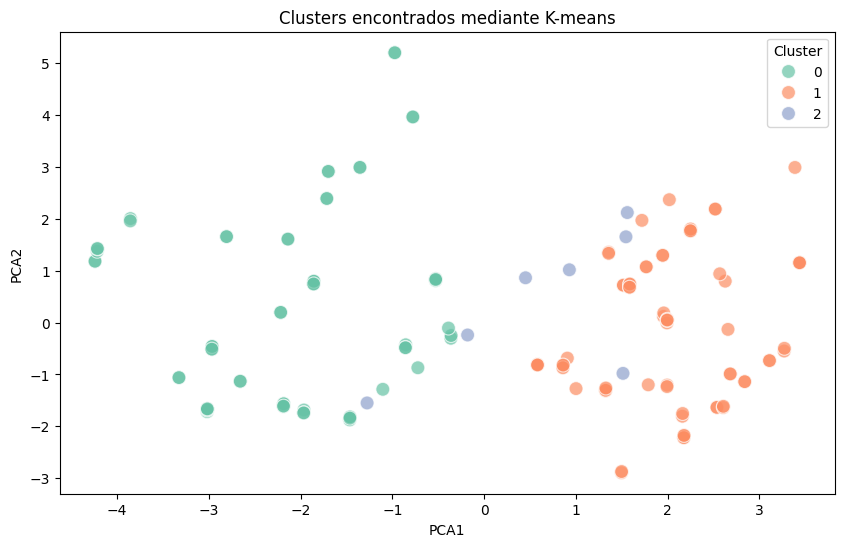

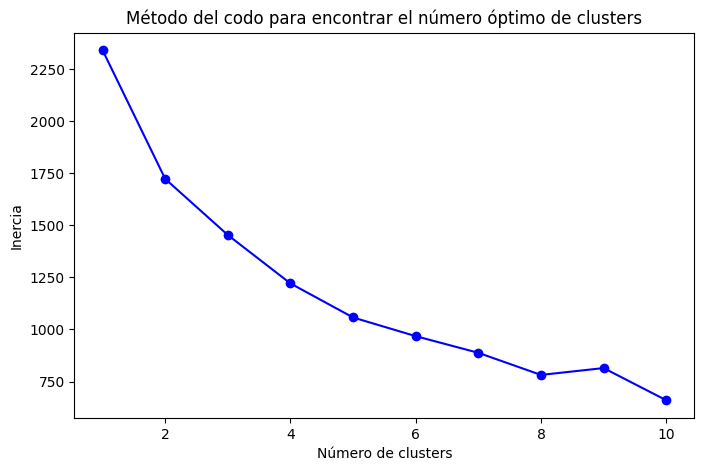

In [79]:
# Seleccionar solo las columnas numéricas (K-means solo trabaja con datos numéricos)
numeric_columns = df_unido.select_dtypes(include=['float64', 'int64']).columns
df_numeric = df_unido[numeric_columns].dropna()  # Eliminar filas con valores NaN

# Normalizar los datos para que todas las características tengan la misma escala
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_numeric)

# Aplicar K-means para encontrar clusters
# Definir el número de clusters que queremos encontrar
kmeans = KMeans(n_clusters=3, random_state=42)  # Cambia n_clusters para buscar más o menos grupos
kmeans.fit(df_scaled)

# Agregar los clusters al DataFrame original
df_numeric['Cluster'] = kmeans.labels_

# Visualizar los clusters usando PCA (reducción de dimensionalidad a 2 componentes)
pca = PCA(n_components=2)
df_pca = pca.fit_transform(df_scaled)

# Crear un DataFrame con los resultados de PCA
df_pca = pd.DataFrame(df_pca, columns=['PCA1', 'PCA2'])
df_pca['Cluster'] = kmeans.labels_

# Graficar los clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_pca, x='PCA1', y='PCA2', hue='Cluster', palette='Set2', s=100, alpha=0.7)
plt.title('Clusters encontrados mediante K-means')
plt.show()

# Evaluar el número óptimo de clusters
# Utilizamos el método del codo para determinar el número óptimo de clusters
inertia = []
K = range(1, 11)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_scaled)
    inertia.append(kmeans.inertia_)

# Graficar la inercia para encontrar el "codo"
plt.figure(figsize=(8, 5))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.title('Método del codo para encontrar el número óptimo de clusters')
plt.show()


# Análisis

  - Se observan patrones de agrupación en los datos. Usando la técnica de **K-means**, indetificamos **tres clusters distintos**.
  - **Método del codo**:El método del codo confirma que **tres o cuatro clusters** es una opción razonable para segmentar los datos, ya que la reducción en la inercia comienza a estabilizarse después de este punto.
  - Los puntos representados en el gráfico de **PCA** muestran que los datos se agrupan en diferentes regiones del espacio bidimensional, lo que sugiere que hay características compartidas entre los individuos dentro de cada cluster.

  - Los tres clusters tienen una diferenciación clara en el espacio **PCA**. Aunque algunos puntos de los clusters 1 y 2 (en naranja y azul) pueden estar cercanos unos de otros, en general, los puntos pertenecientes a cada grupo están razonablemente separados.
  - La normalización y reducción de dimensionalidad nos permiten observar que los datos contienen variables que son útiles para segmentar a los egresados en grupos con características similares. Esto será crucial para definir perfiles de **eventos**, **voluntariado**, **liderazgo**.





# ***Pregunta 10: ¿Se deberían normalizar las imágenes para visualizarlas mejor? No se usan imágenes***

No Aplica

# **Pregunta 11: ¿Hay desequilibrio en las clases de la variable objetivo?**

Para este análisis haremos iniciativa por iniciativa

###**Líder de generación**

<ipython-input-80-e5c26c72bac7>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_counts.index, y=class_counts.values, palette='viridis')


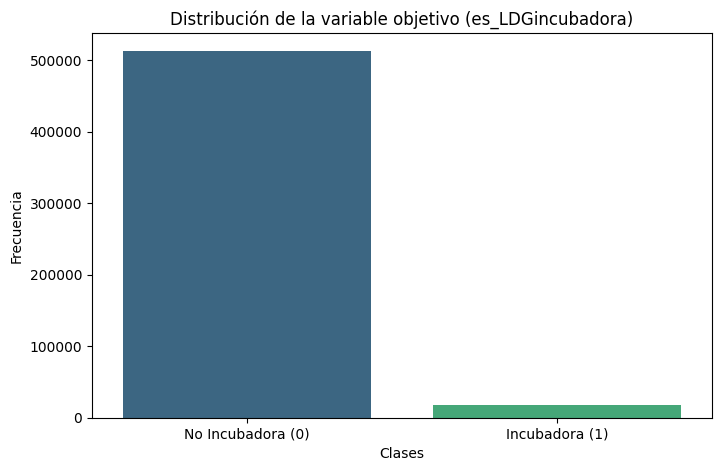

Proporción de clase 0 (No Incubadora): 96.70%
Proporción de clase 1 (Incubadora): 3.30%


In [80]:
#Análisis estadístico
# Conteo de las clases
class_counts = df_unidoLDG['es_LDGincubadora'].value_counts()

# Visualización del desequilibrio
plt.figure(figsize=(8, 5))
sns.barplot(x=class_counts.index, y=class_counts.values, palette='viridis')
plt.title('Distribución de la variable objetivo (es_LDGincubadora)')
plt.xlabel('Clases')
plt.ylabel('Frecuencia')
plt.xticks([0, 1], ['No Incubadora (0)', 'Incubadora (1)'])
plt.show()

# Imprimir proporción
print(f"Proporción de clase 0 (No Incubadora): {class_counts[0] / sum(class_counts) * 100:.2f}%")
print(f"Proporción de clase 1 (Incubadora): {class_counts[1] / sum(class_counts) * 100:.2f}%")


##Análisis
###**Iniciativa Líder de Generación**
El conjunto de datos presenta un claro desequilibrio de clases, donde la mayoría de los registros no forman parte de la iniciativa incubadora. Esta diferencia podría causar problemas durante la fase de modelado, ya que los modelos pueden inclinarse a predecir mayoritariamente la clase mayoritaria. Se sugiere aplicar técnicas de re-balanceo de datos como oversampling o undersampling para mitigar este efecto.